$\textbf{Import Modules and Set Options}$

In [1]:
#file handling
import os
import glob

#data handling
from functools import reduce
from datetime import datetime, timedelta
import numpy as np
import pandas as pd
import networkx as nx

#plotting
import matplotlib as mpl
import matplotlib.pyplot as plt
from matplotlib import cm, colors
from matplotlib.ticker import PercentFormatter
import matplotlib.animation as animation

#mapping
#IMPORT THESE PACKAGES IF YOU WANT TO VISUALISE MAPS BELOW
#import cartopy.io.shapereader as shpreader
#import cartopy.crs as ccrs
#import cartopy

#jupyter notebook display
from IPython.display import HTML

#set options
pd.set_option('display.max_columns', 125)
pd.set_option('display.max_rows', 125)

#check memory
# from psutil import virtual_memory
# mem = virtual_memory()
# print(f'Free memory Available: {round(mem.available/(10**9),3)}GB')

$\textbf{Define Utility Functions}$

In [2]:
#define path length function
def path_lengths(G):
    '''(neworkX Graph) yields num
    
    Generator function yields the distance for each source->destination pair in a given graph G.
    '''
    length_iter = nx.shortest_path_length(G) #nx.shortest_path_length returns a generator, which we define length_iter as
    for source, dist_map in length_iter: #loops through a dict-like object where each value is distance to key node from source
        for dest, dist in dist_map.items(): #for each destination/distance pair
            yield dist #yield distance as a geneartor

def characteristic_path_length(G):
    '''(networkX Graph) --> float
    
    Returns the mean of a list of all path lengths in a graph G.
    '''
    return np.mean(list(path_lengths(G)))

def extract_dataframe(df, column, handle_nulls=True):
    '''(dataframe, str) -> dataframe
    
    Function takes a given dataframe and a specified column and extracts the array of dictionaries into a new dataframe.
    
    If rows in the array are of top None, then we replace this with an NULL row in out new dataframe.
    '''
    assert np.isin(column, df.columns)
    if not handle_nulls:
        return pd.DataFrame(df[column].to_list())
    else:
        try: #tries to get column keys from nested dataframe, raises exception if subsetted df is empty
            keys = df[column][df[column].notna()].iloc[0].keys() #assumes keys for first entry are the same for all
        except IndexError as err:
            print(f'Dataframe passed likely empty, see error: {err}')
            return
        return pd.DataFrame(list(map(lambda x: dict.fromkeys(keys, None) if x is None else x, df[column])))
    
def crosscorr(datax, datay, lag=0):
    """ Lag-N cross correlation. 
    Parameters
    ----------
    lag : int, default 0
    datax, datay : pandas.Series objects of equal length

    Returns
    ----------
    crosscorr : float
    """
    return datax.corr(datay.shift(lag))

$\textbf{Import Data and Build Dataframes}$

In [3]:
#import edges for the .csv files corresponding to each month
edges_by_month = {file.split('_',1)[0].split('/',1)[1] : pd.read_csv(file) for file in glob.glob('*data/network/*edges.csv')}

#concatenate all month files and sum for overlap transits
edges = pd.concat(edges_by_month.values()).groupby(['date','departure_airport_key','arrival_airport_key'])['transits'].sum().reset_index()

#specify timeseries date range
start_date = pd.to_datetime('2019-12-16')
end_date = pd.to_datetime('2020-05-26')
date_rng = pd.date_range(start_date,end_date)

#subset edges dataframe on date range
edges.date = pd.to_datetime(edges.date)
edges = edges.loc[(edges.date >= start_date) & (edges.date <= end_date)]

#import node csvs (airports)
#airports = pd.read_csv('data/network/airport_nodes.csv') #no state information
airports = pd.read_csv('data/airports_geonames.csv') #this has information about states

#we only take edges where the airport keys match airport nodes with geoname ids for complete geographical data
edges = edges.loc[
    (edges.departure_airport_key.isin(airports.airport_key)) &
    (edges.arrival_airport_key.isin(airports.airport_key))
]

#display
edges.info()
display(edges.head(), edges.tail())
airports.info()
display(airports.head())

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2529522 entries, 150469 to 2838395
Data columns (total 4 columns):
 #   Column                 Dtype         
---  ------                 -----         
 0   date                   datetime64[ns]
 1   departure_airport_key  int64         
 2   arrival_airport_key    int64         
 3   transits               int64         
dtypes: datetime64[ns](1), int64(3)
memory usage: 96.5 MB


,date,departure_airport_key,arrival_airport_key,transits
150469,2019-12-16,22,26,1
150470,2019-12-16,26,1343,1
150471,2019-12-16,26,1776,1
150472,2019-12-16,26,4331,2
150473,2019-12-16,51,66,2


,date,departure_airport_key,arrival_airport_key,transits
2838391,2020-05-26,6424,5127,2
2838392,2020-05-26,6424,6425,2
2838393,2020-05-26,6425,5127,2
2838394,2020-05-26,6425,6424,2
2838395,2020-05-26,6431,6096,1


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6330 entries, 0 to 6329
Data columns (total 21 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   airport_key     6330 non-null   int64  
 1   airport         6330 non-null   object 
 2   airport_icao    6330 non-null   object 
 3   latitude_x      6330 non-null   float64
 4   longitude_x     6330 non-null   float64
 5   timezone        6330 non-null   object 
 6   city            6330 non-null   object 
 7   country         6330 non-null   object 
 8   continent       6330 non-null   object 
 9   country_code    6314 non-null   object 
 10  geoname_id      6330 non-null   int64  
 11  name            6330 non-null   object 
 12  asciiname       6330 non-null   object 
 13  alternatenames  6320 non-null   object 
 14  admin1_code     5899 non-null   object 
 15  admin2_code     4264 non-null   object 
 16  latitude_y      6330 non-null   float64
 17  longitude_y     6330 non-null   f

,airport_key,airport,airport_icao,latitude_x,longitude_x,timezone,city,country,continent,country_code,geoname_id,name,asciiname,alternatenames,admin1_code,admin2_code,latitude_y,longitude_y,haversine,state,county
0,1,Anaa,NTGA,-17.050000,-145.41667,Pacific/Tahiti,Anaa,French Polynesia,Oceania,PF,6947726,Anaa Airport,Anaa Airport,"AAA,Anaa,NTGA,Анаа",NaN,NaN,-17.34908,-145.51229,34.772701,NaN,NaN
1,2,Ahe Airport,NTHE,-14.428056,-146.25694,Pacific/Tahiti,Ahe,French Polynesia,Oceania,PF,7668372,Ahe Airport,Ahe Airport,"AHE,Aerodrome d'Ahe,Ahe Airport,Aérodrôme d'Ah...",03,10295319,-14.42810,-146.25700,0.008105,Îles Tuamotu-Gambier,Manihi
2,3,Apataki,NTGD,-15.416667,-146.08333,Pacific/Tahiti,Apataki,French Polynesia,Oceania,PF,7730695,Apataki Airport,Apataki Airport,"APK,Aeroport d'Apataki,Apataki Airport,Aéropor...",03,10295216,-15.57360,-146.41499,39.591594,Îles Tuamotu-Gambier,Arutua
3,4,Atuona,NTMN,-9.769324,-139.00978,Pacific/Marquesas,Atuona,French Polynesia,Oceania,PF,4020109,Atuona,Atuona,"AUQ,Atouana,Atuana,Atuona",04,10295183,-9.80342,-139.04202,5.182125,Îles Marquises,Hiva-Oa
4,5,Arutua,NTGU,-15.250000,-146.75000,Pacific/Tahiti,Arutua,French Polynesia,Oceania,PF,7730127,Arutua Airport,Arutua Airport,"AXR,Aeroport d'Arutua,Arutua Airport,Aéroport ...",03,NaN,-15.23592,-146.65310,10.512974,Îles Tuamotu-Gambier,NaN


In [4]:
#create views (subgraphs) on network for each date
networks = {}
print(f'Network Build Start time: {datetime.now()}')
#timer
start_time = datetime.now()

#loop through each date and build network
for view_date in date_rng:
    date_key = str(view_date.date())
    networks[date_key] = nx.DiGraph()
    networks[date_key].add_weighted_edges_from(edges.loc[edges.date == view_date,['departure_airport_key','arrival_airport_key','transits']].values)
    
#timer
end_time = datetime.now()
print(f'Network Build Processing Completed In Approximately: {(end_time - start_time).seconds}s {(end_time - start_time).microseconds/1000}ms.')
    #add node attributes to each date
#    nx.set_node_attributes(networks[view_date], airport_cases_by_country(networks[view_date]), 'country_cases')

Network Build Start time: 2020-05-30 23:31:24.783913
Network Build Processing Completed In Approximately: 6s 637.401ms.


In [5]:
#concept hierarchies to gruop by
hierarchy_cols = ['continent','country','city','airport']

#define mapping function - keys are index and values are hierarchical multiindex columns
def airport_mapper(hierarchy_cols = ['continent','country','city','airport']):
    return {name: tuple(value) for name, value
            in zip(airports.airport_key.values,airports.loc[:,hierarchy_cols].to_numpy())}

def degrees_df(networks, hierarchy_cols, 
               date_rng = date_rng, direction = 'in', weight = 'weight', fill=0):
    #check direction is valid (in or out for degree calculations)
    direction = direction.lower()
    assert direction in ('in','out')

    #calculate degrees based on direction
    if direction == 'in':
        data = [dict(graph.in_degree(weight=weight)) for graph in networks.values()]
    elif direction == 'out':
        data = [dict(graph.out_degree(weight=weight)) for graph in networks.values()]
        
    #build dataframe
    degrees = pd.DataFrame(
            data = data,
            index = pd.to_datetime(list(networks.keys()))
        ).fillna(fill)
        
    #set index and columns
    degrees.index.name = 'Date'
    degrees.columns = pd.MultiIndex.from_arrays(
        np.stack(degrees.columns.map(airport_mapper())).T,
        names=hierarchy_cols)
    #sort based on hierarchical columns
    degrees.sort_index(axis=1, inplace=True)
    return degrees

In [6]:
#define dataframe timeseries of degree distributions
degrees = {direction : degrees_df(networks, hierarchy_cols, direction = direction) for direction in ('in','out')}

def degrees_by_hierarchy(degree_df, hierarchy = 'country', ncols = None, ascending = False, 
                         weekly=False, normalised = False):
    #group by hierarchy and sum degrees
    df = degree_df.T.groupby(hierarchy).sum().T
    #subset grouped df by the rankings of values for the first row of data, with limit n
    df_cols = df.iloc[0].sort_values(ascending=ascending)
    #subset limit
    if ncols is None:
        ncols = len(df_cols)
    assert type(ncols) == int
    if weekly:
        df = df.loc[:, df_cols.index[:ncols]].reset_index().groupby(
                pd.Grouper(key='Date', freq='W-MON', closed='left')
            ).mean()
    else:
        df = df.loc[:, df_cols.index[:ncols]]
    if normalised:
        return df.divide(df.sum(axis=1), axis=0)
    else:
        return df
    
country_degrees = degrees_by_hierarchy(degrees['in'], ncols = 50, weekly=False)#, normalised = True)
continent_degrees = degrees_by_hierarchy(degrees['in'], hierarchy='continent', weekly=False)#, normalised = True)

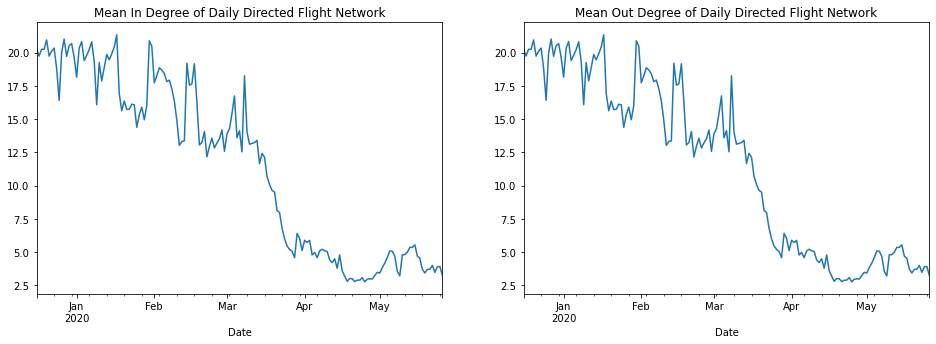

In [7]:
#instantiate axes and plot degrees (in, out) over time
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(16,5))
for i, (direction, df) in enumerate(degrees.items()):
    #plot mean degrees in two subplots
    np.mean(degrees[direction],axis=1).plot(
        kind='line', ax = axes[i], title=f'Mean {direction.capitalize()} Degree of Daily Directed Flight Network')

#fig.savefig('figures/global_mean_degree_subplots.png', bbox_inches='tight')
plt.show()

We define some utility functions to better handle the calculation and visualisation of the degree distribution of our network.

In [8]:
def from_seq(seq, normalize=True, sort=True, ascending=True, name = 'prob',
             dropna=True, na_position='last', **options):
    """Make a PMF from a sequence of values.

    seq: any kind of sequence
    normalize: whether to normalize the Pmf, default True
    sort: whether to sort the Pmf by values, default True
    ascending: whether to sort in ascending order, default True
    dropna: whether to drop NaN values, default True
    na_position: If ‘first’ puts NaNs at the beginning,
                    ‘last’ puts NaNs at the end.
    options: passed to the pd.Series constructor

    :return: Pmf object
    
    (Taken from ThinkComplexity2 code)
    """
    # compute the value counts
    series = pd.Series(seq).value_counts(normalize=normalize,
                                         sort=False,
                                         dropna=dropna)

    pmf = pd.DataFrame(series, columns=[name])

    # sort in place, if desired
    if sort:
        pmf.sort_index(ascending=ascending,
                       inplace=True,
                       na_position=na_position)

    return pmf

def build_pmf(sequence, max_degrees = None, name='prob'):
    #build pmf of degress k in G
    pmf = from_seq(sequence) #create pmf values

    #define x axis range:
    if max_degrees is None:
        max_degrees = int(max(sequence))
    
    assert type(max_degrees) == int
    
    #add in values of k that do not have counts (i.e. between 0 and max):    
    for i in range(max_degrees): #for i in iteration
        if i not in pmf.index: #if i not already represented in pmf dataframe
            pmf = pmf.append(pd.Series({name:0}, name=i)) #add in a row where the prob of i is 0

    pmf.sort_index(inplace=True) #sort dataframe
    pmf.index = pmf.index.astype(int)
    return pmf

def degree_distrib_subplots(sequence, interpolate_line = True, max_degrees = None, bins=100, name = 'prob'):
    '''(NetworkX Graph) --> None
    
    Function takes a Graph G as input, and an optional parameter max_degrees.
    max_degrees determines the range on the x-axis for the plot.
    interpolate_line is a bool: if True it will smooth the line graph, 
    '''
    
    pmf = build_pmf(sequence, max_degrees = max_degrees, name = name)

    #instantiate axes
    fig, axes = plt.subplots(nrows=1, ncols=2)

    #plot graphs
    #bar graph is most realistic and accurate representation of data
    pmf.plot(kind='bar', figsize=(16,6),rot=0,ax=axes[0])
    #density graph is to visually estimate a power law distribution
    pmf.plot(kind='line',figsize=(16,4),ax=axes[1])

    for ax in axes: #Label axes
        ax.set(xlabel='Degree (k)', ylabel='Probability P(k)')

    fig.suptitle('Probability Distributions for Degrees (k) on our Cities Graph') #figure title
    plt.show()

In [9]:
#list comprehension to build list of pmfs for degree distribtuion for each day
pmfs = list(
    map(
        lambda x, y : pd.Series(x, name = y).value_counts(normalize=True,sort=False, dropna=True),
        degrees['in'].values.astype(int), date_rng
    )
)

#fill values with 0 for nonexistent degrees (degrees of count 0 excluded by default)
for pmf in pmfs:
    for i in range(int(degrees['in'].values.max().max())): #for i in iteration
        if i not in pmf.index: #if i not already represented in pmf dataframe
            pmf = pmf.append(pd.Series({pmf.name:0}, name=i))
            
#merge pmfs of degree distributions for each day
degree_distributions = reduce(
    lambda left, right : pd.merge(left, right, left_index = True, right_index=True, how='outer'),
    pmfs
).fillna(0).sort_index().T.sort_index()

#display in degree distribution dataframe
degree_distributions

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,...,977,984,998,1008,1010,1015,1018,1019,1021,1025,1034,1036,1038,1040,1051,1053,1059,1073,1074,1078,1079,1080,1081,1089,1092,1094,1096,1098,1100,1101,1103,1104,1105,1106,1108,1112,1113,1116,1117,1118,1121,1123,1124,1127,1128,1129,1135,1138,1144,1149,1150,1154,1156,1160,1162,1164,1172,1173,1175,1184,1206,1218
2019-12-16,0.488694,0.080837,0.055116,0.044658,0.033635,0.024025,0.019503,0.015263,0.016111,0.013567,0.010458,0.010175,0.009045,0.007066,0.007066,0.006783,0.005936,0.005370,0.007066,0.004240,0.002261,0.003392,0.002261,0.003392,0.005936,0.001979,0.002544,0.003109,0.001413,0.002544,0.001413,0.000565,0.001131,0.000565,0.000565,0.002261,0.001696,0.001413,0.000848,0.001696,0.001413,0.000283,0.000565,0.001696,0.000565,0.000848,0.001979,0.001131,0.001413,0.001413,0.001131,0.001131,0.001131,0.001131,0.000565,0.000848,0.000848,0.000283,0.001696,0.000283,0.000565,0.000848,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.000283,0.0,0.000000,0.0,0.000283,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2019-12-17,0.485302,0.086772,0.055399,0.042397,0.030526,0.024308,0.020350,0.016111,0.017241,0.013850,0.011306,0.011023,0.006783,0.010458,0.006783,0.004240,0.003957,0.005088,0.007349,0.004522,0.004240,0.003109,0.004522,0.003109,0.003392,0.002826,0.001979,0.000848,0.002261,0.003109,0.001696,0.001131,0.002544,0.001413,0.000283,0.001131,0.001131,0.002544,0.001979,0.000565,0.001413,0.001131,0.001131,0.001131,0.001696,0.001131,0.000565,0.000848,0.000283,0.000283,0.001413,0.000565,0.001696,0.000848,0.000565,0.001696,0.001413,0.000565,0.001413,0.000848,0.000283,0.000565,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000283,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000,0.0,0.000283,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2019-12-18,0.487564,0.082533,0.052572,0.040418,0.029395,0.023460,0.024590,0.019785,0.015263,0.016393,0.008762,0.010741,0.007914,0.008762,0.006783,0.006783,0.006218,0.006501,0.003957,0.005653,0.003109,0.003109,0.004522,0.002826,0.002261,0.001979,0.001979,0.002261,0.002826,0.001413,0.000848,0.003109,0.001413,0.000848,0.000848,0.002826,0.001979,0.001696,0.001413,0.001979,0.000848,0.001131,0.001131,0.000848,0.000848,0.001413,0.000565,0.001413,0.000565,0.001696,0.001131,0.000565,0.000565,0.000565,0.000848,0.000848,0.001979,0.001413,0.000283,0.000565,0.000283,0.001131,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.000283,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000,0.0,0.000000,0.0,0.000000,0.0,0.0,0.0,0.000283,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2019-12-19,0.481628,0.085359,0.060204,0.039005,0.029960,0.027134,0.022046,0.020350,0.013850,0.011871,0.012154,0.008762,0.005936,0.008197,0.008197,0.006218,0.007349,0.004522,0.005088,0.004805,0.003392,0.004805,0.003392,0.002544,0.003674,0.004240,0.002261,0.002544,0.001413,0.001696,0.001131,0.000565,0.000848,0.001979,0.001413,0.001413,0.001696,0.001131,0.000000,0.001979,0.000283,0.001696,0.001131,0.000000,0.001979,0.000848,0.000848,0.001131,0.001131,0.001696,0.001696,0.001413,0.000000,0.001413,0.001696,0.000848,0.001413,0.000565,0.000565,0.001413,0.000565,0.000283,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.000283,0.0,0.0,0.0,0.0,0.000000,0.0,0.000000,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.000283,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2019-12-20,0.485868,0.072923,0.059073,0.038722,0

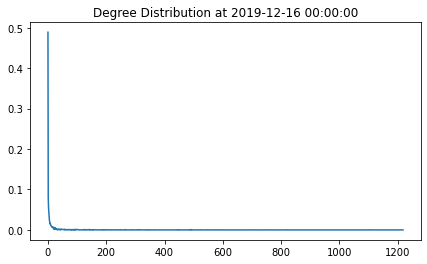

In [10]:
degree_distributions.loc[start_date].plot(kind='line', figsize=(7,4)
                                          ,title = f'Degree Distribution at {start_date}')
plt.show()

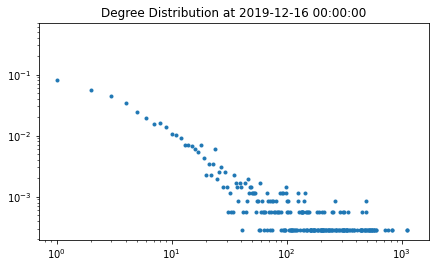

In [11]:
degree_distributions.loc[start_date].plot(ls='',marker='.', loglog=True, figsize=(7,4),
                                         title = f'Degree Distribution at {start_date}')
plt.show()

In [12]:
#write better degree distribution function to plot
#we use this in our animations in the code at the end of the notebook
def draw_degree_distribution(date):
    df = degree_distributions.loc[date]
    ax.clear()
    df.plot(ls='',marker='.', loglog=True)
    ax.set_title('Degree Distribution of Flight Network')
    ax.set_ylabel('Proportion of Nodes')
    ax.set_xlabel('Degree')
    ax.set_ylim(10**-4,1)
    ax.grid(which='major',axis='x', linestyle='-')
    ax.text(0.9, 0.8, date.date(), transform=ax.transAxes, color='#777777', size=24, ha='right', weight=400)
    plt.box(False)

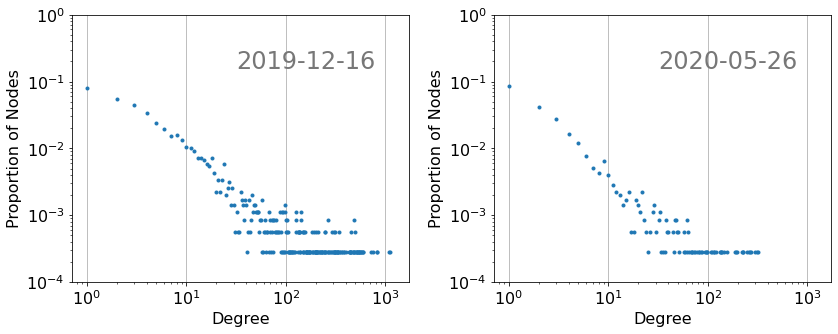

In [13]:
#static img
fig, axes = plt.subplots(ncols=2,figsize=(12,5))

for i, date in enumerate((start_date,end_date)):
    degree_distributions.loc[date].plot(ls='',marker='.',loglog=True, ax=axes[i], fontsize=16)
    axes[i].set_ylabel('Proportion of Nodes', fontsize=16)
    axes[i].set_xlabel('Degree', fontsize=16)
    axes[i].set_ylim(10**-4,1)
    axes[i].grid(which='major',axis='x', linestyle='-')
    axes[i].text(0.9, 0.8, date.date(), transform=axes[i].transAxes, color='#777777', size=24, ha='right', weight=400)
#fig.suptitle('Degree Distribution on Log-Log Scale for Start and End of Timeseries', fontsize=14)
fig.tight_layout(pad=2.0)
#fig.savefig('figures/degree_distrib_subplots.png', bbox_inches='tight')
plt.show()

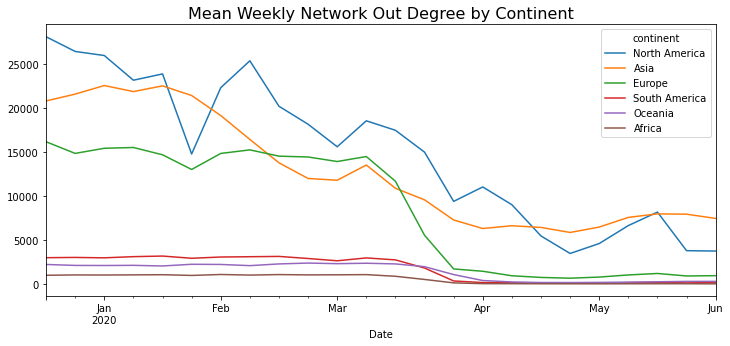

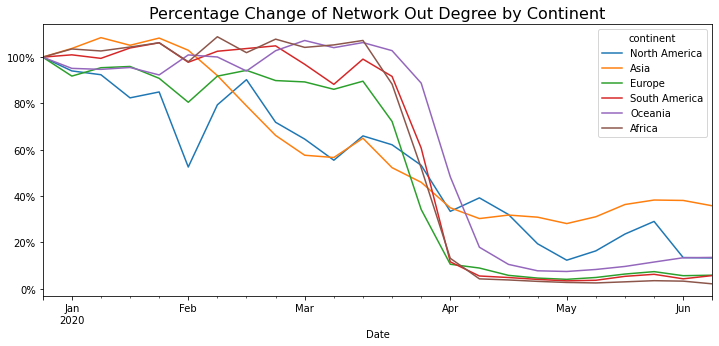

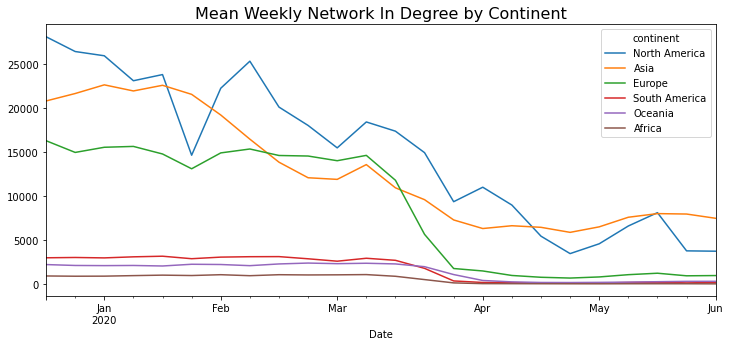

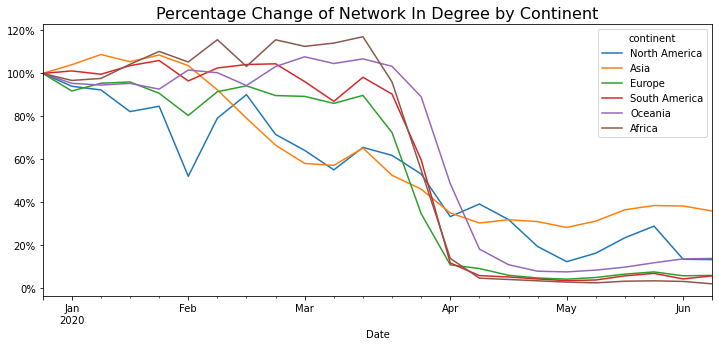

In [14]:
weekly_country_degrees = degrees_by_hierarchy(degrees['in'], ncols = 50, weekly=True)#, normalised = True)
weekly_continent_degrees = degrees_by_hierarchy(degrees['out'], hierarchy='continent', weekly=True)#, normalised = True)


fig, ax = plt.subplots(figsize=(12,5))
weekly_continent_degrees.plot(kind='line',ax=ax)
ax.set_title('Mean Weekly Network Out Degree by Continent', fontsize=16)
plt.show()
#fig.savefig('figures/mean_weekly_network_out_degree_by_continent.png', bbox_inches='tight')


df = weekly_continent_degrees.reset_index().groupby(
    pd.Grouper(key='Date', freq='W-MON', closed='left')
).mean()
fig, ax = plt.subplots(figsize=(12,5))
df.divide(df.iloc[0]).plot(kind='line',ax=ax)
ax.set_title('Percentage Change of Network Out Degree by Continent', fontsize=16)

ax.yaxis.set_major_formatter(PercentFormatter(1))
plt.show()
#fig.savefig('figures/percentage_change_out_degree_by_continent.png', bbox_inches='tight')


fig, ax = plt.subplots(figsize=(12,5))
weekly_continent_degrees = degrees_by_hierarchy(degrees['in'], hierarchy='continent', weekly=True)#, normalised = True)
weekly_continent_degrees.plot(kind='line',ax=ax)
ax.set_title('Mean Weekly Network In Degree by Continent', fontsize=16)
plt.show()
#fig.savefig('figures/mean_weekly_network_in_degree_by_continent.png', bbox_inches='tight')


df = weekly_continent_degrees.reset_index().groupby(
    pd.Grouper(key='Date', freq='W-MON', closed='left')
).mean()
fig, ax = plt.subplots(figsize=(12,5))
df.divide(df.iloc[0]).plot(kind='line',ax=ax)
ax.set_title('Percentage Change of Network In Degree by Continent', fontsize=16)
ax.yaxis.set_major_formatter(PercentFormatter(1))
plt.show()
#fig.savefig('figures/percentage_change_in_degree_by_continent.png', bbox_inches='tight')

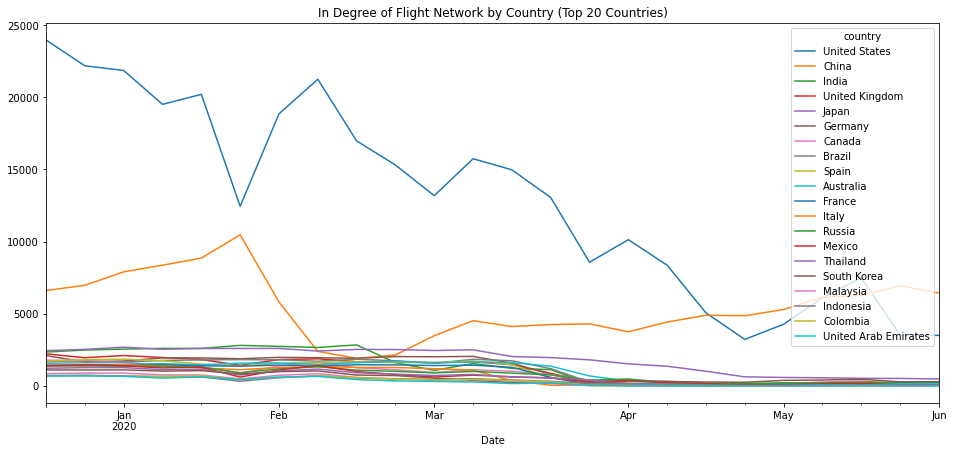

In [15]:
#plot degrees - hard to distinguish lines on bottom of chart
(degrees_by_hierarchy(
    degrees['in'], 
    ncols = 20).
 reset_index().
 groupby(
     pd.Grouper(
         key='Date', freq='W-MON', closed='left'
     )
 ).
 mean().
 plot(kind='line',figsize=(16,7), title = 'In Degree of Flight Network by Country (Top 20 Countries)')
)

plt.show()

$\textbf{John Hopkins COVID Data}$

Below we import that data from the John Hopkins University COVID-19 GitHub: https://github.com/topics/johns-hopkins-university

In [16]:
#john hopkins university covid-19 global data
confirmed = pd.read_csv('data/covid19/time_series_covid19_confirmed_global.csv')
recovered = pd.read_csv('data/covid19/time_series_covid19_recovered_global.csv')
deaths = pd.read_csv('data/covid19/time_series_covid19_deaths_global.csv')

#get location info from confirmed cases data (first 4 columns)
jhu_loc_info = confirmed.loc[:,['Province/State','Country/Region','Lat','Long']]

#rename columns
confirmed.rename(columns={'Country/Region':'Country', 'Province/State' : 'State'}, inplace=True)
deaths.rename(columns={'Country/Region':'Country', 'Province/State' : 'State'}, inplace=True)

#process
country_confirmed = confirmed.drop(columns=['Lat','Long','State']).groupby('Country').sum().T
country_deaths = deaths.drop(columns=['Lat','Long','State']).groupby('Country').sum().T
country_confirmed.index = pd.to_datetime(country_confirmed.index)
country_deaths.index = pd.to_datetime(country_deaths.index)

#china only data
china_conf = confirmed.loc[confirmed.Country == 'China'].drop(columns=['Lat','Long']).groupby('State').sum().T
china_deaths = deaths.loc[deaths.Country == 'China'].drop(columns=['Lat','Long']).groupby('State').sum().T

#us only data
us_confirmed = pd.read_csv('data/covid19/time_series_covid19_confirmed_US.csv')
us_deaths = pd.read_csv('data/covid19/time_series_covid19_deaths_US.csv')

#drop outside us territories for this mapping exercise
us_confirmed = us_confirmed.loc[us_confirmed.Admin2.notna()]
us_deaths = us_deaths.loc[us_deaths.Admin2.notna()]

#extract only relevant data
excess_info_cols = ['UID','iso2','iso3','code3','FIPS', 'Admin2', 'Lat', 'Long_', 'Combined_Key']
us_confirmed = us_confirmed.drop(columns=excess_info_cols).rename(columns={'Province_State':'State'}).groupby(['State']).sum().T
us_deaths = us_deaths.drop(columns=excess_info_cols + ['Population','Country_Region']).rename(columns={'Province_State':'State'}).groupby(['State']).sum().T

us_confirmed.index = pd.to_datetime(us_confirmed.index)
us_deaths.index = pd.to_datetime(us_deaths.index)

#aus confirmed
aus_conf = confirmed.loc[confirmed.Country == 'Australia'].drop(columns=['Country','Lat','Long']).set_index('State').T
aus_conf.index = pd.to_datetime(aus_conf.index)

In [17]:
#fixing some discrepancies between geographical data and coronavirus data
rename_countries = {
    'Korea, South' : 'South Korea',
    'US' : 'United States',
    'Taiwan*' : 'Taiwan',
    'Czechia' : 'Czech Republic',
    'Macau' : 'Macao'
}

country_confirmed['Hong Kong'] = china_conf['Hong Kong'].values
country_confirmed.rename(columns=rename_countries, inplace=True)

#countries
country_degrees = {direc : degrees_by_hierarchy(degrees[direc], hierarchy='country', ncols=100, weekly=False) for direc in ('in','out')}#, normalised = True)
continent_degrees = {direc : degrees_by_hierarchy(degrees[direc], hierarchy='continent', weekly=False) for direc in ('in','out')}

#country to continent map dictionary
countries_to_continents = {x[1] : x[0] for x in np.intersect1d(degrees['in'].columns,degrees['out'].columns)}
country_list = list(countries_to_continents.keys())
continent_list = np.unique(list(countries_to_continents.values()))

#subset countries
country_conf = country_confirmed.copy()
for direc in ('in','out'):
    country_conf = country_conf.loc[:,country_conf.columns.isin(country_degrees[direc])]
    country_degrees[direc] = country_degrees[direc].loc[:,country_degrees[direc].columns.isin(country_conf.columns)]

#continents confirmed
continent_conf = country_conf.T
continent_conf.index = continent_conf.index.map(countries_to_continents)
continent_conf.index.name = 'Continent'
continent_conf = continent_conf.reset_index().groupby('Continent').sum().T

#get flight degree information by state
us_state_mapper = airports.loc[airports.country == 'United States',hierarchy_cols + ['state']].set_index(hierarchy_cols).to_dict()['state']
state_degrees = degrees['in'].loc[:,degrees['in'].columns.get_level_values('country') == 'United States']
state_degrees.columns = state_degrees.columns.map(us_state_mapper)
state_degrees = state_degrees.T.reset_index().rename(columns={'index':'State'}).groupby('State').sum().T
state_degrees

mixed_degrees = pd.merge(state_degrees, country_degrees['in'].drop(columns='United States'), left_index=True, right_index=True)

#specify top 50 degree nodes
top50 = mixed_degrees.iloc[0].sort_values(ascending=False)[:50]

In [18]:
#top50 states and countries ranked by degree
top50

China                   5979.0
California              2764.0
India                   2495.0
United Kingdom          2442.0
Japan                   2391.0
Texas                   2268.0
Germany                 2244.0
Florida                 2001.0
Canada                  1918.0
Brazil                  1785.0
Spain                   1720.0
Australia               1640.0
France                  1638.0
Italy                   1559.0
Russia                  1407.0
Illinois                1405.0
Mexico                  1367.0
New York                1357.0
Thailand                1198.0
Georgia                 1181.0
South Korea             1075.0
North Carolina          1038.0
Virginia                 880.0
Malaysia                 863.0
Colorado                 830.0
Indonesia                714.0
Washington               703.0
Colombia                 698.0
United Arab Emirates     685.0
Norway                   684.0
Pennsylvania             681.0
Saudi Arabia             673.0
Netherla

In [19]:
NUM_COLORS = 20
focustop = top50[:NUM_COLORS]
cm = plt.get_cmap('tab20')
focustop

China             5979.0
California        2764.0
India             2495.0
United Kingdom    2442.0
Japan             2391.0
Texas             2268.0
Germany           2244.0
Florida           2001.0
Canada            1918.0
Brazil            1785.0
Spain             1720.0
Australia         1640.0
France            1638.0
Italy             1559.0
Russia            1407.0
Illinois          1405.0
Mexico            1367.0
New York          1357.0
Thailand          1198.0
Georgia           1181.0
Name: 2019-12-16 00:00:00, dtype: float64

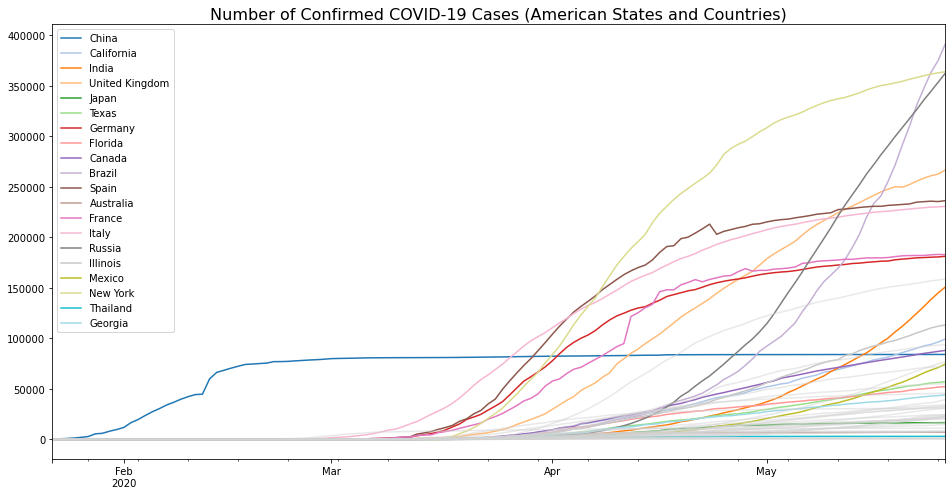

In [20]:
#plot covid cases by top 50 countries
fig, ax = plt.subplots(figsize=(16,8))
ax.set_prop_cycle(color=[cm(1.*i/NUM_COLORS) for i in range(NUM_COLORS)])

#top20
pd.merge(
    country_conf.loc[:,country_conf.columns.isin(focustop.index)],
    us_confirmed.loc[:,us_confirmed.columns.isin(focustop.index)],
    left_index = True,
    right_index = True
)[focustop.index.to_list()].plot(kind='line', ax=ax) # [[focustop.index]] resorts according to rank
#top30
pd.merge(
    country_conf.loc[:,(country_conf.columns.isin(top50.index)) & (~country_conf.columns.isin(focustop.index))],
    us_confirmed.loc[:,(us_confirmed.columns.isin(top50.index)) & (~us_confirmed.columns.isin(focustop.index))],
    left_index = True,
    right_index = True
).plot(kind='line', ax=ax, legend=False, color='lightgrey', alpha=0.5)
ax.set_title('Number of Confirmed COVID-19 Cases (American States and Countries)', fontsize=16)
#fig.savefig('figures/covid_cases_top_20.png', bbox_inches='tight')
plt.show()

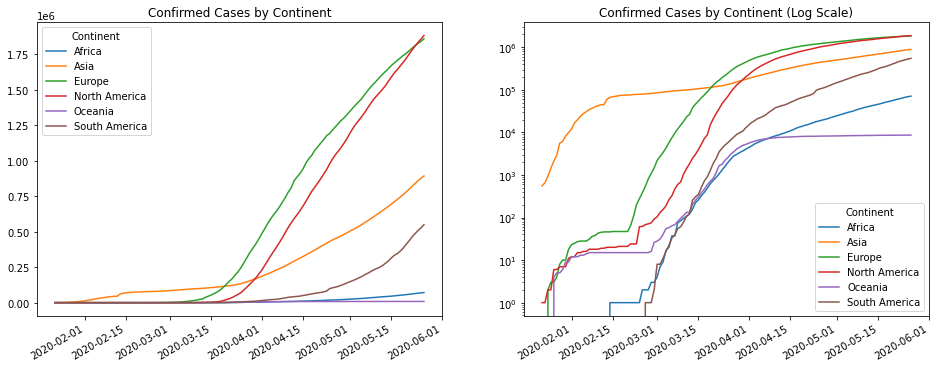

In [21]:
fig, axes = plt.subplots(ncols=2,figsize=(16,6))
continent_conf.plot(kind='line', ax=axes[0], title='Confirmed Cases by Continent')
continent_conf.plot(kind='line', ax=axes[1], logy=True, title='Confirmed Cases by Continent (Log Scale)')
#fig.savefig('figures/continent_confirmed.png', bbox_inches='tight')
plt.show()

$\textbf{Building Animations}$

The following code snippets below build our animations used for this project.

The animations of network degree are relatively easy to run, but the world map animations are a bit more substantial. However we have commented out the code lines that build the animation to prevent accidental running of this code as it does take some time and requires installation of some software other than simply Python packages, such as `ffmpeg`.

The `animator.save` will build the animation and save it to the specified directory.
The `HTML` call on hte `animator` will display the animation in line in the Jupyter Notebook. This is much slower than saving to disk and viewing outside of Jupyter.

In [27]:
#mapping
#IMPORT THESE PACKAGES IF YOU WANT TO VISUALISE MAPS BELOW
import cartopy.io.shapereader as shpreader
import cartopy.crs as ccrs
import cartopy

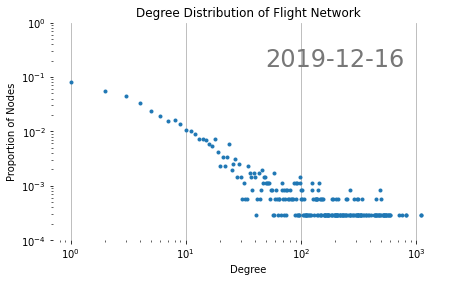

In [28]:
#animation
fig, ax = plt.subplots(figsize=(7,4))
animator = animation.FuncAnimation(
    fig, draw_degree_distribution, frames = date_rng
)

#animator.save('animations/degree_distribution.mp4', fps=5, extra_args=['-vcodec', 'libx264'])

#HTML(animator.to_jshtml())

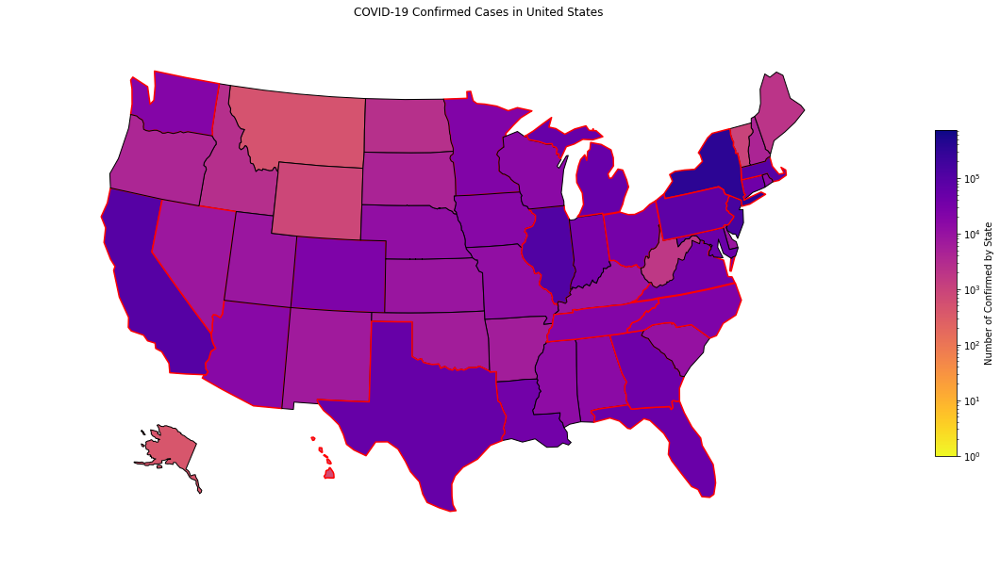

In [29]:
## color maps
#log-transformer for numerical values to colors
norm = colors.LogNorm(vmin=us_confirmed.values.min()+1, vmax=2*us_confirmed.values.max())
cmap = plt.get_cmap('plasma_r') #reverse the order of hot colormap

#base ax
fig , ax = plt.subplots(figsize=(16,8))
ax.set_visible(False)

#map projection
projection = ccrs.AlbersEqualArea(central_longitude=-100)
#projection = ccrs.LambertConformal()

#Continental United States
axus = fig.add_axes([0, 0, 1, 1], projection=projection)
axus.set_extent([-125, -66.5, 20, 50])#, ccrs.Geodetic())

# Hawaii
axhi = fig.add_axes([0.25, .1, 0.15, 0.15], projection=projection)
axhi.set_extent([-155, -165, 20, 15])

# Alaska
axak = fig.add_axes([0.1, 0.1, 0.2, 0.2], projection=projection)
axak.set_extent([-185, -130, 70, 50])


#edgecolor for our maps
edgecolor = 'black'
facecolor = 'white'

shapename = 'admin_1_states_provinces_lakes_shp'
states_shp = shpreader.natural_earth(resolution='110m',
                                     category='cultural', name=shapename)
reader = shpreader.Reader(states_shp)
states_map = reader.records()
#print(list(map(lambda x: x.attributes['name'], states_map)))

for subplot in [axus, axak, axhi]:
    subplot.patch.set_visible(False)
    subplot.spines['geo'].set_visible(False)
    
#Draw all the gray countries just once in an init function
#I also make a dictionary for easy lookup of the geometries by country name later
geom_states = {}
def init_run():
    for n, state in enumerate(states_map):
        #if condition to plot on subplots
        if state.attributes['name'] == 'Alaska':
            a = axak
        elif state.attributes['name'] == 'Hawaii':
            a = axhi
        else:
            a = axus
        #define feature artist geometry based on US/Alaska/Hawaii subregion, and store in geom_states dict
        if state.attributes['name'] in top50:
            feature_artist = a.add_geometries([state.geometry], ccrs.PlateCarree(),
                      facecolor=facecolor, edgecolor='red', linewidth=1.5)
        else:
            feature_artist = a.add_geometries([state.geometry], ccrs.PlateCarree(),
                      facecolor=facecolor, edgecolor=edgecolor)
        geom_states[state.attributes['name']] = feature_artist

def run(frame): #for each iteration of the animation
    axus.set_title('COVID-19 Confirmed Cases in United States')
    date = str(aus_conf.iloc[frame].name.date())
    #Only select dataframe that has values in the keys of our geom_states dict
    us_cases = us_confirmed.loc[:,us_confirmed.columns.isin(list(geom_states.keys()))]
    
    for state in us_cases.columns: #for each state
        cases = us_cases.iloc[frame].loc[state] #subset our case diction by date, state
        geom = geom_states[state] #get geometry object from state name
        if cases == 0:
            facecolor = 'white'
        else:
            facecolor = cmap(norm(cases)) #define a face color mapping (+1 as log(0) undefined)
        geom._feature._kwargs['facecolor'] = facecolor #change the color of the state

#color bar axis
cax = fig.add_axes([0.92, 0.2, 0.02, 0.6])
cb = mpl.colorbar.ColorbarBase(cax, cmap=cmap, norm=norm ,spacing='proportional')
cb.set_label('Number of Confirmed by State')


#build animation
ani_us = animation.FuncAnimation(fig, run, init_func=init_run, frames=125, blit=False)

#save animation
#ani_us.save('animations/us_covid_anim.mp4', fps=10, extra_args=['-vcodec', 'libx264'])

#play animation in IPython
HTML(ani_us.to_jshtml())

Animation size has reached 21098514 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


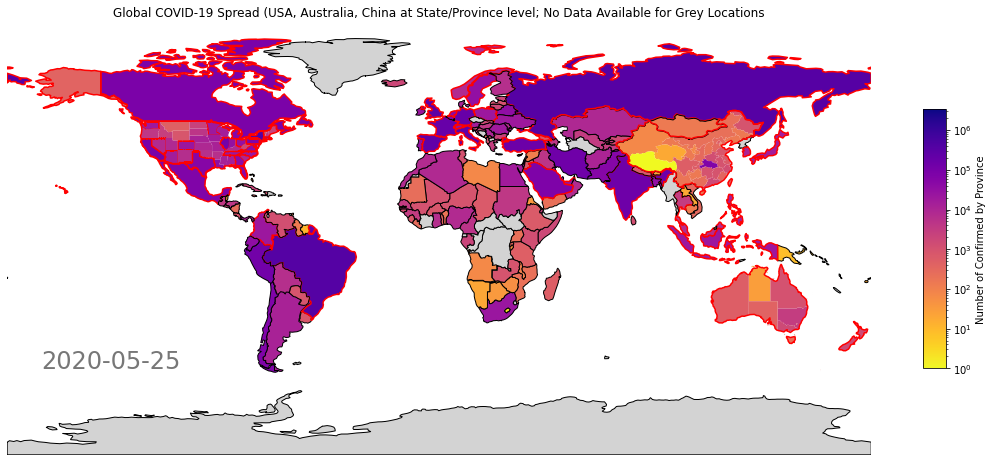

In [31]:
## color maps
#log-transformer for numerical values to colors
norm = colors.LogNorm(
    vmin=confirmed.select_dtypes(np.int64).values.min()+1,
    vmax=2*confirmed.select_dtypes(np.int64).values.max()
)
cmap = plt.get_cmap('plasma_r') #reverse the order of hot colormap

#base ax
fig = plt.figure(figsize=(16,6))

#map projection
projection = ccrs.PlateCarree()
#projection = ccrs.AlbersEqualArea(central_longitude=-100)

#main axis
ax = fig.add_axes([0, 0, 1, 1], projection=projection)

# Date text box
axtext = fig.add_axes([0.1, 0.1, 0.2, 0.2], projection=projection)
axtext.set_extent([-185, -130, 70, 50])

#edgecolor for our maps
edgecolor = 'black'
facecolor = 'lightgray'
focuscolor = 'red'
shpfilename = shpreader.natural_earth(resolution='110m',
                                      category='cultural',
                                      name='admin_0_countries')
country_reader = shpreader.Reader(shpfilename)
country_map = country_reader.records()

states_shape = 'admin_1_states_provinces_lakes_shp'
states_shp = shpreader.natural_earth(resolution='110m',
                                     category='cultural', name=states_shape)
states_reader = shpreader.Reader(states_shp)
states_map = states_reader.records()

# # Downloaded from https://gadm.org/download_country_v3.html
chinafname = 'gadm36_CHN_1.shp'
china_reader = shpreader.Reader(os.path.join('data','gadm36_CHN_shp',chinafname))
province_map = china_reader.records()

# # Downloaded from https://gadm.org/download_country_v3.html
ausfname = 'gadm36_AUS_1.shp'
aus_reader = shpreader.Reader(os.path.join('data', 'gadm36_AUS_shp', ausfname))
aus_map = aus_reader.records()

for a in (ax,axtext):
    a.patch.set_visible(False)
    a.spines['geo'].set_visible(False)
    
#Draw all the gray countries just once in an init function
geom_countries = {}
geom_states = {}
geom_provinces = {}
geom_aus = {}
def init_run():
    #us
    for state in states_map:
        if state.attributes['name'] in top50:
            feature_artist = ax.add_geometries([state.geometry], ccrs.PlateCarree(),
                      facecolor=facecolor, edgecolor=focuscolor, linewidth=1.5)
        else:
            feature_artist = ax.add_geometries([state.geometry], ccrs.PlateCarree(),
                      facecolor=facecolor, edgecolor='none')
        geom_states[state.attributes['name']] = feature_artist
    
    #china
    for province in province_map:
        feature_artist = ax.add_geometries([province.geometry], ccrs.PlateCarree(),
                  facecolor=facecolor, edgecolor='none')
        geom_provinces[province.attributes['NAME_1']] = feature_artist   
    edit_province_names = {
        'Nei Mongol' : 'Inner Mongolia',
        'Ningxia Hui' : 'Ningxia',
        'Xinjiang Uygur' : 'Xinjiang',
        'Xizang' : 'Tibet'
    }
    #edit key names so they match our network's names
    for old_key, new_key in edit_province_names.items():
        if old_key in geom_provinces.keys():
            geom_provinces[new_key] = geom_provinces.pop(old_key)
    
    #australia
    for aus_state in aus_map:
        if aus_state in top50:
            feature_artist = ax.add_geometries([aus_state.geometry], ccrs.PlateCarree(),
                                          facecolor=facecolor, edgecolor=focuscolor, linewidth=1.5)
        else:
            feature_artist = ax.add_geometries([aus_state.geometry], ccrs.PlateCarree(),
                                          facecolor=facecolor, edgecolor='none')
        geom_aus[aus_state.attributes['NAME_1']] = feature_artist
        
    #global
    for country in country_map:
        if country.attributes['NAME'] in top50 and country.attributes['NAME'] not in ('United States', 'China','Australia'):
            feature_artist = ax.add_geometries([country.geometry], ccrs.PlateCarree(),
                                              facecolor=facecolor, edgecolor=focuscolor, linewidth=1.5)
        elif country.attributes['NAME'] in ('United States of America', 'China','Australia'): #we do this manually
            feature_artist = ax.add_geometries([country.geometry], ccrs.PlateCarree(),
                      facecolor="none", edgecolor=focuscolor, linewidth=1.5)
        else:
            feature_artist = ax.add_geometries([country.geometry], ccrs.PlateCarree(),
                      facecolor=facecolor, edgecolor=edgecolor)
        geom_countries[country.attributes['NAME']] = feature_artist
        
    #check geometry files and subset accordingly
    edit_country_names = {
        'Russian Federation' : 'Russia',
        'Dem. Rep. Korea' : 'North Korea',
        'Republic of Korea' : 'South Korea',
        'Åland Islands' : 'Aland Islands',
        "Côte d'Ivoire" : 'Ivory Coast',
        'Timor-Leste': 'East Timor',
        'Federated States of Micronesia' : 'Micronesia',
        'Brunei Darussalam' : 'Brunei',
        'São Tomé and Principe' : 'Sao Tome and Principe',
        'United States Virgin Islands' : 'U.S. Virgin Islands',
        'Lao PDR' : 'Laos',
        'Wallis and Futuna Islands' : 'Wallis and Futuna',
        'The Gambia' : 'Gambia',
        'Republic of Cabo Verde' : 'Cape Verde',
    }
    #edit key names so they match our network's names
    for old_key, new_key in edit_country_names.items():
        if old_key in geom_countries.keys():
            geom_countries[new_key] = geom_countries.pop(old_key)

def run(frame): #for each iteration of the animation
    ax.set_title('Global COVID-19 Spread (USA, Australia, China at State/Province level; No Data Available for Grey Locations')
    date = str(aus_conf.iloc[frame].name.date())
    axtext.clear()
    axtext.text(0.2, 0.2, date, transform=ax.transAxes, color='#777777', size=24, ha='right', weight=400)
    #global
    #Only select dataframe that has values in the keys of our geom_countries dict
    global_cases = country_confirmed.loc[:,country_confirmed.columns.isin(list(geom_countries.keys()))]
    for country in global_cases.columns: #for each state
        if country not in ('United States of America', 'China','Australia'):
            cases = global_cases.iloc[frame].loc[country] #subset our case diction by date, country
            geom = geom_countries[country] #get geometry object from country name
            if cases == 0:
                facecolor = 'lightyellow'
            else:
                facecolor = cmap(norm(cases)) #define a face color mapping (+1 as log(0) undefined)
            geom._feature._kwargs['facecolor'] = facecolor #change the color of the state
    
    #us
    #Only select dataframe that has values in the keys of our geom_states dict
    us_cases = us_confirmed.loc[:,us_confirmed.columns.isin(list(geom_states.keys()))]
    for state in us_cases.columns: #for each state
        cases = us_cases.iloc[frame].loc[state] #subset our case diction by date, state
        geom = geom_states[state] #get geometry object from state name
        if cases == 0:
            facecolor = 'lightyellow'
        else:
            facecolor = cmap(norm(cases)) #define a face color mapping (+1 as log(0) undefined)
        geom._feature._kwargs['facecolor'] = facecolor #change the color of the state
    
    #china
    #Only select dataframe that has values in the keys of our geom_countries dict
    china_cases = china_conf.loc[:,china_conf.columns.isin(list(geom_provinces.keys()))]
    for province in china_cases.columns: #for each province
        cases = china_cases.iloc[frame].loc[province] #subset our case diction by date, prvoince
        geom = geom_provinces[province] #get geometry object from province
        if cases == 0:
            facecolor = 'lightyellow'
        else:
            facecolor = cmap(norm(cases)) #define a face color mapping (+1 as log(0) undefined)
        geom._feature._kwargs['facecolor'] = facecolor #change the color of the state
        
    #australia
    for aus_state in aus_conf.columns:
        cases = aus_conf.iloc[frame].loc[aus_state]
        geom = geom_aus[aus_state]
        if cases == 0:
            facecolor = 'lightyellow'
        else:
            facecolor = cmap(norm(cases))
        geom._feature._kwargs['facecolor'] = facecolor

#color bar axis
cax = fig.add_axes([0.92, 0.2, 0.02, 0.6])
cb = mpl.colorbar.ColorbarBase(cax, cmap=cmap, norm=norm ,spacing='proportional')
cb.set_label('Number of Confirmed by Province')


#build animation
ani = animation.FuncAnimation(fig, run, init_func=init_run, frames=125, blit=False)

#save animation
#ani.save('animations/covid_anim_atrisk.mp4', fps=5, extra_args=['-vcodec', 'libx264'])

#play animation in IPython
HTML(ani.to_jshtml())

#if you display in jupyter you will exceed the default limit for number of points in a matplotlib anim
#change this below to enable proper display
mpl.rcParams['animation.embed_limit'] = 20971520.0 * 100